In [67]:
import torch
from torch import nn
import torch.nn.utils.prune as prune
import torch.nn.functional as F

from torchvision.models import alexnet, AlexNet_Weights
from torchvision.io import read_image
from torchvision import transforms, datasets
from PIL import Image
import time
import numpy as np

from functools import partial
from torchvision.transforms._presets import ImageClassification
from torchvision.transforms import functional as F, InterpolationMode
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from torchvision.models import resnet50

import copy

In [12]:
print(f"torch version: {torch.__version__}")


# Check if there are multiple devices (i.e., GPU cards)-
print(f"Number of GPU(s) available = {torch.cuda.device_count()}")

if torch.cuda.is_available():
    print(f"Current GPU: {torch.cuda.current_device()}")
    print(f"Current GPU name: {torch.cuda.get_device_name(torch.cuda.current_device())}")
else:
    print("PyTorch does not have access to GPU")

# Device configuration-
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Available device is {device}')

torch version: 2.2.2+cu121
Number of GPU(s) available = 1
Current GPU: 0
Current GPU name: NVIDIA GeForce RTX 3060 Laptop GPU
Available device is cuda


In [68]:
# Step 1: Initialize model with the best available weights
weights = AlexNet_Weights.IMAGENET1K_V1
model = alexnet(weights=weights)
model.to(device)
model.eval()
print(model)

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

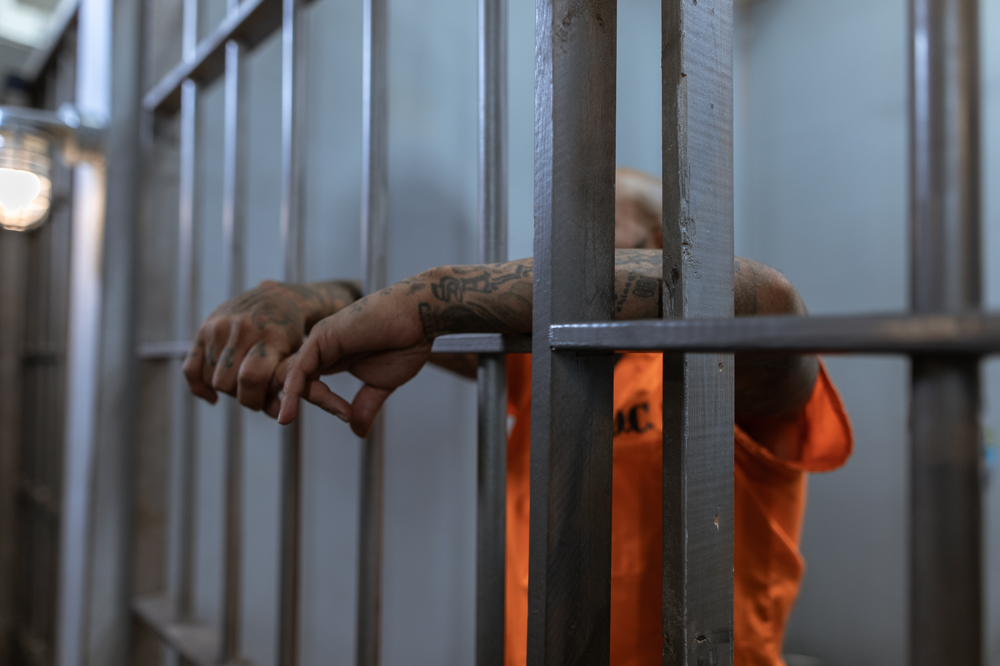

In [84]:
img = Image.open("prison.jpg")

display(img)

InterpolationMode = InterpolationMode.BILINEAR
resize_size = 256
crop_size=[224]
rgb_img = F.resize(img, resize_size, interpolation=InterpolationMode, antialias=True)
rgb_img = F.center_crop(rgb_img, crop_size)
rgb_img = np.array(rgb_img).astype(float)/255
# rgb_img = F.convert_image_dtype(img, torch.float)

# display(Image.fromarray(rgb_img))


convert_tensor = transforms.ToTensor()
img = convert_tensor(img)

# Step 2: Initialize the inference transforms
preprocess = weights.transforms()

# Step 3: Apply inference preprocessing transforms
batch = preprocess(img).unsqueeze(0).to(device)

In [85]:
# Step 4: Use the model and print the predicted category
top_k = 5
prediction = model(batch).squeeze(0).softmax(0)
class_ids = prediction.topk(k=top_k)
for i in range(top_k):
    class_id = class_ids[1][i].item()
    score = prediction[class_id].item()
    category_name = weights.meta["categories"][class_id]
    print(f"{category_name}: {100 * score:.1f}%")

prison: 80.3%
padlock: 2.6%
chime: 1.9%
shoji: 0.9%
crib: 0.8%


In [16]:
# from imagenet_mini_loader import get_train_loader, get_test_loader
# train_loader = get_train_loader(transform=preprocess)
# test_loader = get_test_loader(transform=preprocess)

def load(path,num_workers=4):
    # dataset = datasets.ImageFolder(root=path,transform = preprocess)
    # train_size = int(0.7 * len(dataset))
    # test_size = len(dataset) - train_size
    # train_set, test_set = torch.utils.data.random_split(dataset, [train_size, test_size])

    
    train_set = datasets.ImageFolder(root=path+'/train', transform=preprocess)
    test_set = datasets.ImageFolder(root=path+'/val', transform=preprocess)
    
    train_loader = torch.utils.data.DataLoader(
        train_set,
        batch_size=50,
        num_workers=num_workers,
        shuffle=False
    )
    
    test_loader = torch.utils.data.DataLoader(
        test_set,
        batch_size=50,
        num_workers=num_workers,
        shuffle=False
    )

    return train_loader, test_loader

train_loader, test_loader = load('imagenet_mini/imagenet-mini', num_workers=8)
print(f"train loaders: {train_loader}")

train loaders: <torch.utils.data.dataloader.DataLoader object at 0x0000024F3EB06C30>


In [17]:
criterion=nn.CrossEntropyLoss()
optimizer=torch.optim.Adam(model.classifier.parameters(),lr=0.001)
epochs = 10

In [72]:
def eval_model(model):
    tst_corr = 0
    tst_tot = 0
    loss_tot = 0
    batches = 0
    with torch.no_grad():
        for b, (X_test,y_test) in enumerate(test_loader):
            y_test = y_test.to(device) ###added
            X_test = X_test.to(device)       
            y_val=model(X_test)
            predicted=torch.max(y_val.data,1)[1]
            btach_corr=(predicted==y_test).sum()
            btach_tot=len(y_test)
            tst_corr+=btach_corr
            tst_tot+=btach_tot
            loss=criterion(y_val,y_test)
            loss=loss.cpu().detach().numpy()
            loss_tot+=loss
            batches += 1
            # if b%100==0:
            #     print(f"loss: {loss_tot/batches}, accuracy: {tst_corr/tst_tot}")

    print(f"loss: {loss_tot/batches}, accuracy: {tst_corr/tst_tot}")

eval_model(model)

loss: 1.8895512132705012, accuracy: 0.5630894303321838


In [75]:
new_model =  copy.deepcopy(model)
new_model.train()
for name, module in new_model.named_modules():
    # prune 30% of connections in all 2D-conv layers
    if isinstance(module, torch.nn.Conv2d):
        prune.l1_unstructured(module, name='weight', amount=0.3)
    # prune 60% of connections in all linear layers
    elif isinstance(module, torch.nn.Linear):
        prune.l1_unstructured(module, name='weight', amount=0.6)

print(dict(new_model.named_buffers()).keys())  # to verify that all masks exist

dict_keys(['features.0.weight_mask', 'features.3.weight_mask', 'features.6.weight_mask', 'features.8.weight_mask', 'features.10.weight_mask', 'classifier.1.weight_mask', 'classifier.4.weight_mask', 'classifier.6.weight_mask'])


In [76]:
eval_model(new_model)

loss: 2.271217383915865, accuracy: 0.4899311661720276


In [29]:
start_time=time.time()
train_losses=[]
test_losses=[]
train_correct=[]
test_correct=[]
new_model.train()

for i in range(epochs):
    trn_corr=0
    tst_corr=0
    tot = 0
    for b, (X_train,y_train) in enumerate(train_loader):
        b+=1
        y_train = y_train.to(device) ###added
        X_train = X_train.to(device)
        y_pred=new_model(X_train)
        loss=criterion(y_pred,y_train)       
        #Update parameters
        predicted=torch.max(y_pred.data,1)[1]
        batch_corr=(predicted==y_train).sum()
        trn_corr+= batch_corr
        tot += len(y_train)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        if b%200==0:
            print(f'epoch: {i:2}  batch: {b:4} [{tot:6}/8000]  loss: {loss.item():10.8f}  \
accuracy: {trn_corr.item()*100/(tot):7.3f}%')
    
    if device == 'cuda':
        loss=loss.cpu().detach().numpy()
    else:
        loss=loss.detach().numpy()
    train_losses.append(loss)
    train_correct.append(trn_corr)
                  
    with torch.no_grad():
        for b, (X_test,y_test) in enumerate(test_loader):
            y_test = y_test.to(device) ###added
            X_test = X_test.to(device)
            # X_test.to(device)
            # y_test.to(device)
            b+=1
                  
            y_val=new_model(X_test)
            predicted=torch.max(y_val.data,1)[1]
            btach_corr=(predicted==y_test).sum()
            tst_corr+=btach_corr

    loss=criterion(y_val,y_test)
    if device == 'cuda':
        loss=loss.cpu().detach().numpy()
    else:
        loss=loss.detach().numpy()
    test_losses.append(loss)
    test_correct.append(tst_corr)
                  
print(f'\nDuration: {time.time() - start_time:.0f} seconds')     

epoch:  0  batch:  200 [  6400/8000]  loss: 3.76013994  accuracy:  44.438%
epoch:  0  batch:  400 [ 12800/8000]  loss: 2.82972336  accuracy:  44.117%
epoch:  0  batch:  600 [ 19200/8000]  loss: 2.77435732  accuracy:  43.802%
epoch:  0  batch:  800 [ 25600/8000]  loss: 3.74174976  accuracy:  43.832%
epoch:  0  batch: 1000 [ 32000/8000]  loss: 3.01802516  accuracy:  43.781%


TypeError: can't convert cuda:0 device type tensor to numpy. Use Tensor.cpu() to copy the tensor to host memory first.

In [1]:
eval_model(new_model)

NameError: name 'eval_model' is not defined

In [86]:
top_k = 5
prediction = new_model(batch).squeeze(0).softmax(0)
class_ids = prediction.topk(k=top_k)
for i in range(top_k):
    class_id = class_ids[1][i].item()
    score = prediction[class_id].item()
    category_name = weights.meta["categories"][class_id]
    print(f"{category_name}: {100 * score:.1f}%")

prison: 54.1%
padlock: 4.0%
chime: 1.8%
nail: 1.7%
crib: 1.0%


In [58]:
def grad_cam_visualization(model, target_layers=None):
    if target_layers == None:
        target_layers = [model.features[-1]]
    input_tensor = batch # Create an input tensor image for your model..
    # Note: input_tensor can be a batch tensor with several images!

    # Construct the CAM object once, and then re-use it on many images:
    cam = GradCAM(model=model, target_layers=target_layers)

    # You can also use it within a with statement, to make sure it is freed,
    # In case you need to re-create it inside an outer loop:
    # with GradCAM(model=model, target_layers=target_layers) as cam:
    #   ...

    # We have to specify the target we want to generate
    # the Class Activation Maps for.
    # If targets is None, the highest scoring category
    # will be used for every image in the batch.
    # Here we use ClassifierOutputTarget, but you can define your own custom targets
    # That are, for example, combinations of categories, or specific outputs in a non standard model.

    targets = [ClassifierOutputTarget(281)]

    # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
    grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

    # In this example grayscale_cam has only one image in the batch:
    grayscale_cam = grayscale_cam[0, :]
    visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)

    # You can also get the model outputs without having to re-inference
    model_outputs = cam.outputs
    return visualization

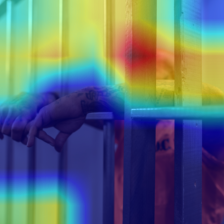

In [73]:
display(Image.fromarray(grad_cam_visualization(model)))

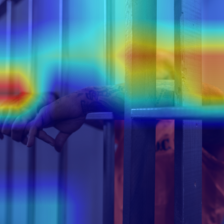

In [77]:
display(Image.fromarray(grad_cam_visualization(new_model)))